# Irradiated Monkeys
This data anlysis attempts to aply machine learning concepts to analyze the patterns and make predictions related to Rhesus monkeys housed by Wake Forest University and in collaboration with Dr. Thomas Johnson of Colorado State University and Dr. Susan Bailey of Colorado Atate Uiversity. The monkeys were irradiated with differnt doses, types, and frequencies of radiation, and blood analytics were frequently measured after radiation. The health records of the monkeys were also recorded, and all monkeys that aare iving are still being monitored. Thus, in this notebook I will test the following:
- 1.) Can machine learning cluster patterns in monkey response to radiation?
- 2.) Can machine learning make accurate blood analytic predicitons?
- 3.) Can machine learning predict the health statuses of the monkeys?
- 4.) What features contribute most to the end biomarker and prognostic statuses of the monkeys? 

# Data handling

In [1]:
### Using monkey_env/ ###
### If giving a tqb error, run this code twice###

# handling data
import pandas as pd
import numpy as np
import datetime

# visualizing data
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("darkgrid")

# Statistics
from scipy import stats
#import statsmodels.api as sm
#import statsmodels.imputation.mice as smi
#import scipy.cluster.hierarchy as hac
#from statsmodels.stats.multicomp import pairwise_tukeyhsd
import matplotlib.gridspec as gridspec
import math
import random


#SHAP Value stuff
import shap
from shap import TreeExplainer
from shap import GradientExplainer
from shap import DeepExplainer
from shap import KernelExplainer
from shap import SamplingExplainer
from shap import PartitionExplainer

#ML stuff
import catboost
from catboost import CatBoostClassifier, Pool, CatBoostRegressor, CatBoost

#language handling
#import bert


#from mxnet import nd, autograd, gluon
#from mxnet.gluon import nn, rnn
#import mxnet as mx

#fix the error that pops up about ipwydgets 
from tqdm import tqdm

print("Setup Complete")

/Users/aidanlew/Desktop/cmb/codes/monkey_env/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Setup Complete


In [2]:
pwd

'/Users/aidanlew/Desktop/cmb/codes/monkey_irrad_sept-2022'

In [3]:
cd '/Users/aidanlew/Documents'

/Users/aidanlew/Documents


In [5]:
def parser(x):
    return datetime.datetime.strptime(x,'%d-%m-%y')


In [6]:
#Makee a df were all the data is present (except irrad data for the controls)
solid_monkey_df = pd.read_excel('../Documents/full_monkey_data_r2.xlsx',
                    #sheet_name=1,
                    skiprows = 0,
                    usecols = ['ID', 'Species', 'SAMPLE_DATE', 'IRRAD', 'IRRAD_DATE', 'DOB', 'SEX',
       'TYPE', 'DAYS_SINCE_IRRAD', 'MONTHS_SINCE_IRRAD', 'MONTHS AT IRRAD',
       'DOSE_(Gy)', 'AGE', 'WBC_(K/uL)', 'RBC_(M/uL)', 'Hemaglobin_(HGB_g/dL)',
       'Hemocrit_(HCT_%)', 'Mean_corpuscular_volume_(MCV_fL)',
       'Mean_corpuscular_hemaglobin_(MCH_pg)',
       'Mean_corpuscular_hemaglobin_concentration_(MCHC_g/dL)', 'NEUT_(%)',
       'LYMPHOCYTES_(%)', 'MONO_(%)', 'EOS_(%)', 'BASO_(%)', 'ABS_NEUT_(/uL)',
       'ABS_LYMPH_(/uL)', 'ABS_MONO_(/uL)', 'ABS_EOS_(/uL)', 'ABS_BASO_(/uL)',
       'PLATLET_COUNT_(K/uL)'],
                    engine = 'openpyxl',
                    date_parser=parser
                         )

#Set the index to the monkey ID and make the labels not read as integers
solid_monkey_df.set_index(['ID'])
solid_monkey_df['ID'] = solid_monkey_df['ID'].astype(str)

#solid_monkey_df.dropna(axis=0, inplace=True) 

#solid_monkey_df.columns
solid_monkey_df.tail()

Cannot parse header or footer so it will be ignored


,ID,Species,SAMPLE_DATE,IRRAD,IRRAD_DATE,DOB,SEX,TYPE,DAYS_SINCE_IRRAD,MONTHS_SINCE_IRRAD,...,LYMPHOCYTES_(%),MONO_(%),EOS_(%),BASO_(%),ABS_NEUT_(/uL),ABS_LYMPH_(/uL),ABS_MONO_(/uL),ABS_EOS_(/uL),ABS_BASO_(/uL),PLATLET_COUNT_(K/uL)
4547,2112,Rhesus-Chinese,2020-09-23,No,NaT,1999-09-28,M,Research,NaN,NaN,...,67.0,6.2,1.1,0.0,1696,4422,409,73,0,289
4548,2112,Rhesus-Chinese,2021-03-04,No,NaT,1999-09-28,M,Research,NaN,NaN,...,56.1,9.1,1.5,0.0,1312,2210,359,59,0,284
4549,2210,Rhesus-Indian,2021-09-07,No,NaT,1999-01-01,F,Research,NaN,NaN,...,26.8,12.3,1.2,0.0,3104,1394,640,62,0,311
4550,2210,Rhesus-Indian,2021-09-20,No,NaT,1999-01-01,F,Research,NaN,NaN,...,36.2,10.9,1.7,0.0,2970,2100,632,99,0,348
4551,2210,Rhesus-Indian,2021-10-07,No,NaT,1999-01-01,F,Research,NaN,NaN,...,16.0,21.0,3.0,0.0,3360,896,1176,168,0,329


In [7]:
single_monkey_df = solid_monkey_df.copy()
single_monkey_df = single_monkey_df[single_monkey_df['ID'] == '2046']
single_monkey_df.set_index(['ID'])
#single_monkey_df.reset_index()
single_monkey_df.head()

,ID,Species,SAMPLE_DATE,IRRAD,IRRAD_DATE,DOB,SEX,TYPE,DAYS_SINCE_IRRAD,MONTHS_SINCE_IRRAD,...,LYMPHOCYTES_(%),MONO_(%),EOS_(%),BASO_(%),ABS_NEUT_(/uL),ABS_LYMPH_(/uL),ABS_MONO_(/uL),ABS_EOS_(/uL),ABS_BASO_(/uL),PLATLET_COUNT_(K/uL)
33,2046,Rhesus-Chinese,2017-11-02,Yes,2014-04-09,2007-07-03,F,Clinical,1303.0,43.0,...,44.6,5.5,0.5,0.0,1877,1695,209,19,0,276
34,2046,Rhesus-Chinese,2017-12-13,Yes,2014-04-09,2007-07-03,F,Clinical,1344.0,44.0,...,40.5,7.4,0.0,0.0,3647,2835,518,0,0,386
35,2046,Rhesus-Chinese,2018-01-02,Yes,2014-04-09,2007-07-03,F,Research,1364.0,45.0,...,39.9,6.0,0.3,0.3,2140,1596,240,12,12,309
36,2046,Rhesus-Chinese,2018-01-31,Yes,2014-04-09,2007-07-03,F,Research,1393.0,46.0,...,46.8,5.6,0.5,0.0,2025,2012,241,22,0,275
37,2046,Rhesus-Chinese,2018-04-05,Yes,2014-04-09,2007-07-03,F,Research,1457.0,48.0,...,22.8,5.8,0.1,0.1,6123,1961,499,9,9,325


# Vizualization
    1.) See the blood analytics over time for each monkey
    2.) See the ages of the monkeys
        a.) For the absolute age
        b.) For age at irrad
        c.) For time since irrad
    3.) Comparison of analytics between the control and irrad group (can use a lot of         dist plots)

Total Monkeys:272
Non-Irradiated Samples:970
Irradiated Samples:3582


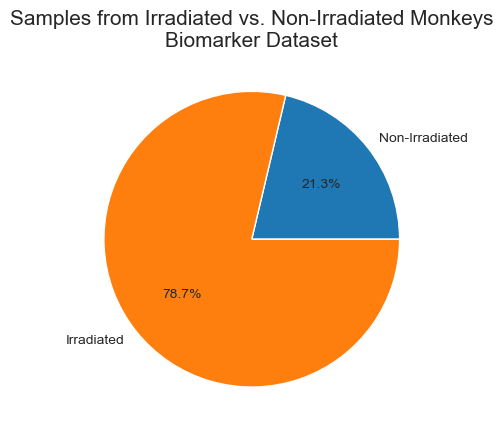

In [77]:
# See our monkey sample size
print('Total Monkeys:{}'.format(solid_monkey_df['ID'].nunique()))
 
# Count the control monkeys
print('Non-Irradiated Samples:{}'.format(solid_monkey_df['IRRAD'].value_counts()['No']))
 
# Count the irradiated monkeys
print('Irradiated Samples:{}'.format(solid_monkey_df['IRRAD'].value_counts()['Yes']))


#plot the proportions of control vs. irrad
labels = 'Non-Irradiated', 'Irradiated'
sizes = [970, 3582,]

fig, ax = plt.subplots()
ax.set_title('Samples from Irradiated vs. Non-Irradiated Monkeys\nBiomarker Dataset',fontsize=15)
ax.pie(sizes, labels=labels, autopct='%1.1f%%')

plt.savefig("bio-irrad-nonirrad-pie.png", dpi=900, bbox_inches='tight')

Males:3608
Females:944


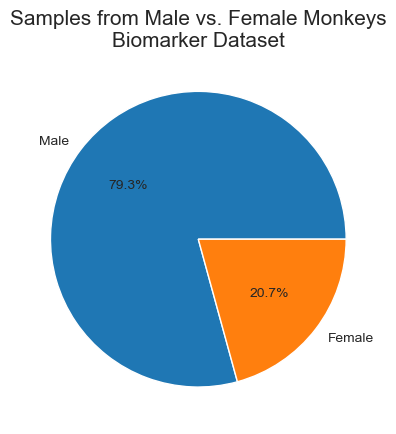

In [78]:
# Count the males
print('Males:{}'.format(solid_monkey_df['SEX'].value_counts()['M']))

# Count the females
print('Females:{}'.format(solid_monkey_df['SEX'].value_counts()['F']))


#plot the proportions of male vs. female
labels = 'Male', 'Female'
sizes = [3608, 944,]

fig, ax = plt.subplots()
ax.set_title('Samples from Male vs. Female Monkeys\nBiomarker Dataset',fontsize=15)
ax.pie(sizes, labels=labels, autopct='%1.1f%%')

plt.savefig("bio-male-female-pie.png", dpi=900, bbox_inches='tight')

## We have 272 monkeys, 31 variables, and 4552 sample dates – get stoked
May need to add some of the monkeys that had missing data, but it's robust enough at the moment


In [20]:
solid_monkey_df.columns

Index(['ID', 'Species', 'SAMPLE_DATE', 'IRRAD', 'IRRAD_DATE', 'DOB', 'SEX',
       'TYPE', 'DAYS_SINCE_IRRAD', 'MONTHS_SINCE_IRRAD', 'MONTHS AT IRRAD',
       'DOSE_(Gy)', 'AGE', 'WBC_(K/uL)', 'RBC_(M/uL)', 'Hemaglobin_(HGB_g/dL)',
       'Hemocrit_(HCT_%)', 'Mean_corpuscular_volume_(MCV_fL)',
       'Mean_corpuscular_hemaglobin_(MCH_pg)',
       'Mean_corpuscular_hemaglobin_concentration_(MCHC_g/dL)', 'NEUT_(%)',
       'LYMPHOCYTES_(%)', 'MONO_(%)', 'EOS_(%)', 'BASO_(%)', 'ABS_NEUT_(/uL)',
       'ABS_LYMPH_(/uL)', 'ABS_MONO_(/uL)', 'ABS_EOS_(/uL)', 'ABS_BASO_(/uL)',
       'PLATLET_COUNT_(K/uL)'],
      dtype='object')

In [21]:
contvirrad_df = solid_monkey_df.copy()
contvirrad_df = contvirrad_df[['IRRAD', 'LYMPHOCYTES_(%)', 'PLATLET_COUNT_(K/uL)',
                               'WBC_(K/uL)', 'RBC_(M/uL)']]
contvirrad_df.head()

,IRRAD,LYMPHOCYTES_(%),PLATLET_COUNT_(K/uL),WBC_(K/uL),RBC_(M/uL)
0,No,48.0,396,10.9,5.05
1,No,21.4,334,8.8,4.59
2,No,8.5,321,17.5,4.74
3,No,5.5,310,21.1,4.76
4,No,14.5,486,11.5,4.53


In [22]:
melt_df = pd.melt(contvirrad_df, id_vars =['IRRAD'], value_vars =['LYMPHOCYTES_(%)', 'PLATLET_COUNT_(K/uL)',
                               'WBC_(K/uL)', 'RBC_(M/uL)'])

melt_df.head()

,IRRAD,variable,value
0,No,LYMPHOCYTES_(%),48.0
1,No,LYMPHOCYTES_(%),21.4
2,No,LYMPHOCYTES_(%),8.5
3,No,LYMPHOCYTES_(%),5.5
4,No,LYMPHOCYTES_(%),14.5


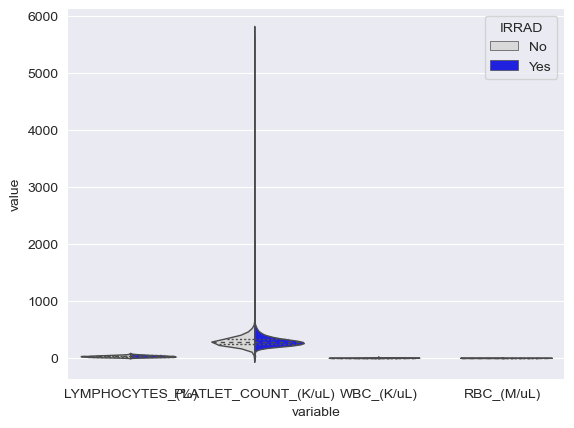

In [23]:
ax =sns.violinplot(data=melt_df, x="variable", y="value", hue="IRRAD",
               split=True, inner="quart", linewidth=1,
               palette={"Yes": "b", "No": ".85"})
sns.despine(left=True)


In [24]:
lymph_df = solid_monkey_df.copy()
lymph_df = lymph_df[['IRRAD', 'LYMPHOCYTES_(%)']]

meltlymph_df = pd.melt(lymph_df, id_vars =['IRRAD'], value_vars =['LYMPHOCYTES_(%)'])

meltlymph_df.head()

,IRRAD,variable,value
0,No,LYMPHOCYTES_(%),48.0
1,No,LYMPHOCYTES_(%),21.4
2,No,LYMPHOCYTES_(%),8.5
3,No,LYMPHOCYTES_(%),5.5
4,No,LYMPHOCYTES_(%),14.5


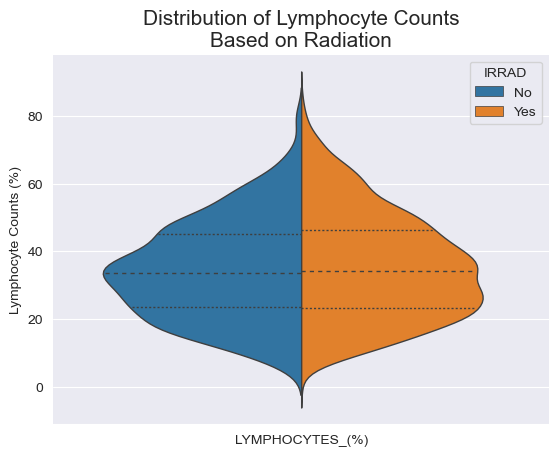

In [28]:
ax = sns.violinplot(data=meltlymph_df, x="variable", y="value", hue="IRRAD",
               split=True, inner="quart", linewidth=1,
               #palette={"Yes": "r", "No": ".85"}
                  )
sns.despine(left=True)
ax.set_xlabel('')
ax.set_ylabel('Lymphocyte Counts (%)')

ax.set_title('Distribution of Lymphocyte Counts\nBased on Radiation',fontsize=15)

plt.savefig("lymph-dist-irrad.png", dpi=900, bbox_inches='tight')

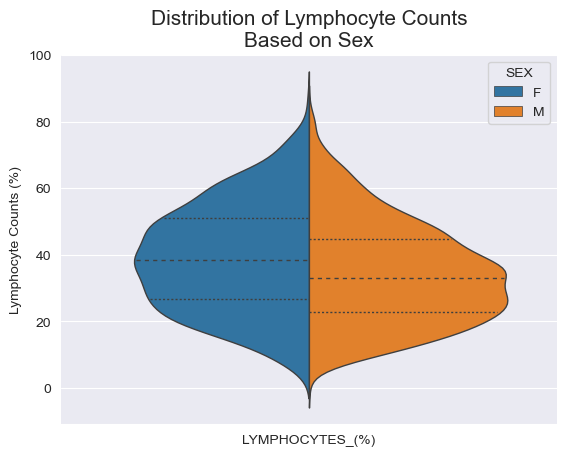

In [27]:

sex_df = solid_monkey_df.copy()
sex_df = sex_df[['SEX', 'LYMPHOCYTES_(%)']]

meltsex_df = pd.melt(sex_df, id_vars =['SEX'], value_vars =['LYMPHOCYTES_(%)'])




ax = sns.violinplot(data=meltsex_df, x="variable", y="value", hue="SEX",
               split=True, inner="quart", linewidth=1,
               #palette={"Yes": "r", "No": ".85"}
                  )

sns.despine(left=True)
ax.set_xlabel('')
ax.set_ylabel('Lymphocyte Counts (%)')

ax.set_title('Distribution of Lymphocyte Counts\nBased on Sex',fontsize=15)

plt.savefig("lymph-dist-sex.png", dpi=900, bbox_inches='tight')

In [31]:
solid_monkey_df.head()

,ID,Species,SAMPLE_DATE,IRRAD,IRRAD_DATE,DOB,SEX,TYPE,DAYS_SINCE_IRRAD,MONTHS_SINCE_IRRAD,...,LYMPHOCYTES_(%),MONO_(%),EOS_(%),BASO_(%),ABS_NEUT_(/uL),ABS_LYMPH_(/uL),ABS_MONO_(/uL),ABS_EOS_(/uL),ABS_BASO_(/uL),PLATLET_COUNT_(K/uL)
0,2061,Rhesus-Chinese,2017-12-20,No,NaT,2007-05-14,F,Clinical,NaN,NaN,...,48.0,7.5,0.9,0.1,4742,5232,818,98,11,396
1,2061,Rhesus-Chinese,2018-01-29,No,NaT,2007-05-14,F,Research,NaN,NaN,...,21.4,4.5,0.1,0.0,6512,1883,396,9,0,334
2,2061,Rhesus-Chinese,2018-04-04,No,NaT,2007-05-14,F,Research,NaN,NaN,...,8.5,3.4,0.1,0.1,15383,1488,595,18,18,321
3,2061,Rhesus-Chinese,2018-08-17,No,NaT,2007-05-14,F,Research,NaN,NaN,...,5.5,2.7,0.1,0.0,19349,1161,570,21,0,310
4,2061,Rhesus-Chinese,2018-12-05,No,NaT,2007-05-14,F,Research,NaN,NaN,...,14.5,6.6,0.1,0.0,9062,1668,759,12,0,486


,DAYS_SINCE_IRRAD,variable,value
33,1303.0,LYMPHOCYTES_(%),44.6
34,1344.0,LYMPHOCYTES_(%),40.5
35,1364.0,LYMPHOCYTES_(%),39.9
36,1393.0,LYMPHOCYTES_(%),46.8
37,1457.0,LYMPHOCYTES_(%),22.8


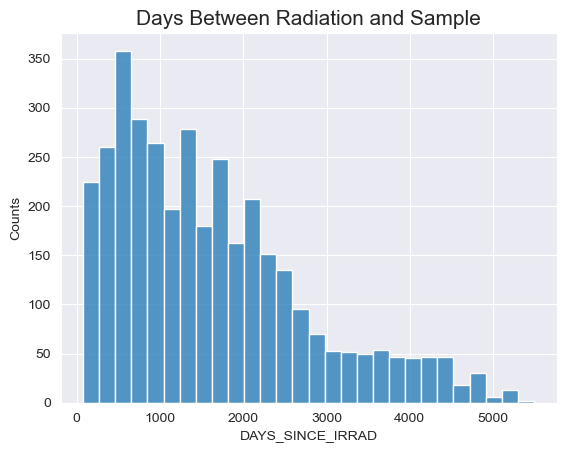

In [45]:
# Make a df for days since irradiation
dsi_df = solid_monkey_df.copy()
dsi_df = dsi_df[['DAYS_SINCE_IRRAD', 'LYMPHOCYTES_(%)']]

meltsdi_df = pd.melt(dsi_df, id_vars =['DAYS_SINCE_IRRAD'], value_vars =['LYMPHOCYTES_(%)']).dropna()
#dsi_df.head()
meltsdi_df.head()


#plot a histogram of the days sice irradiation
ax = sns.histplot(data=meltsdi_df, x="DAYS_SINCE_IRRAD")
ax.set_ylabel('Counts')

ax.set_title('Days Between Radiation and Sample',fontsize=15)

plt.savefig("dayssince-hist.png", dpi=900, bbox_inches='tight')

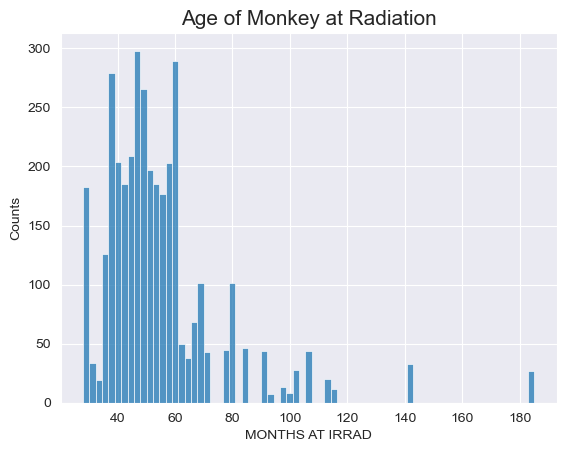

In [46]:
# Make a df for months at irradiation
mai_df = solid_monkey_df.copy()
mai_df = mai_df[['MONTHS AT IRRAD', 'LYMPHOCYTES_(%)']]
mai_df = pd.melt(mai_df, id_vars =['MONTHS AT IRRAD'], value_vars =['LYMPHOCYTES_(%)']).dropna()


#plot a histogram of the months at irradiation
ax = sns.histplot(data=mai_df, x="MONTHS AT IRRAD")
ax.set_ylabel('Counts')

ax.set_title('Age of Monkey at Radiation',fontsize=15)

plt.savefig("monthat-hist.png", dpi=900, bbox_inches='tight')



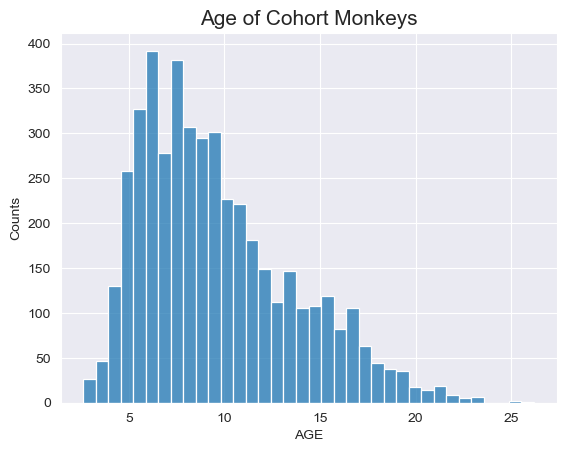

In [48]:
# Make a df for months at irradiation
age_df = solid_monkey_df.copy()
age_df = age_df[['AGE', 'LYMPHOCYTES_(%)']]
age_df = pd.melt(age_df, id_vars =['AGE'], value_vars =['LYMPHOCYTES_(%)']).dropna()


#plot a histogram of the months at irradiation
ax = sns.histplot(data=age_df, x="AGE")
ax.set_ylabel('Counts')

ax.set_title('Age of Cohort Monkeys',fontsize=15)

plt.savefig("age-hist.png", dpi=900, bbox_inches='tight')


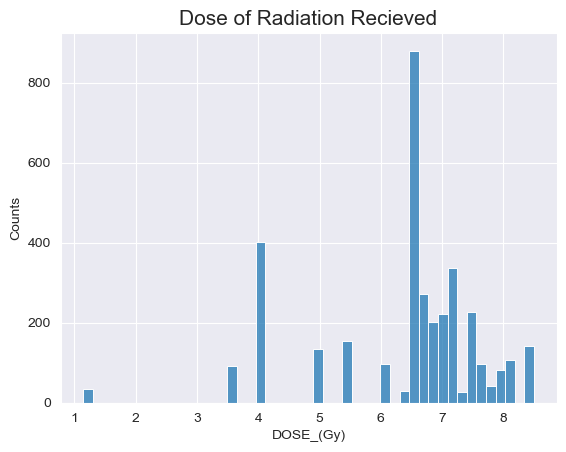

In [47]:
# Make a df for months at irradiation
dose_df = solid_monkey_df.copy()
dose_df = dose_df[['DOSE_(Gy)', 'LYMPHOCYTES_(%)']]
dose_df = pd.melt(dose_df, id_vars =['DOSE_(Gy)'], value_vars =['LYMPHOCYTES_(%)']).dropna()


#plot a histogram of the months at irradiation
ax = sns.histplot(data=dose_df, x='DOSE_(Gy)')
ax.set_ylabel('Counts')

ax.set_title('Dose of Radiation Recieved',fontsize=15)

plt.savefig("dose-hist.png", dpi=900, bbox_inches='tight')


In [59]:
#solid_monkey_df.columns
health_monkey_df.columns

Index(['ID', 'Time_Under_Observation_(yrs)', 'Dose_(Gy)', 'Irrad_Age_(months)',
       'Years_Since_Irrad', 'Current_Age_(years)', 'Animal_Status',
       'Diabetes_(Y/N)', 'Cataracts_(Y/N)', 'Arthritis_(Y/N)',
       'Periodontitis_(Y/N)', 'GI_(Y/N)', 'Behavior_(Y/N)', 'Tumor_(Y/N)',
       'Heart_(Y/N)', 'Hypertension_(Y/N)', 'Testicular Atrophy_(Y/N)',
       'Ovarian Dysfunction_(Y/N)', 'Hepatic_(Y/N)', 'Kidney_(Y/N)',
       'Lung_(Y/N)', 'Bone_(Y/N)', 'Overweight_(Y/N)', 'Underweight_(Y/N)',
       'Brain Lesion_(Y/N)'],
      dtype='object')

In [75]:
# Table of all the variables
df = pd.DataFrame({
    "Blood Biomarker Dataset": ['ID', 'Species', 'SAMPLE_DATE', 'IRRAD', 'IRRAD_DATE', 'DOB', 'SEX',
       'TYPE', 'DAYS_SINCE_IRRAD', 'MONTHS_SINCE_IRRAD', 'MONTHS AT IRRAD',
       'DOSE_(Gy)', 'AGE', 'WBC_(K/uL)', 'RBC_(M/uL)', 'Hemaglobin_(HGB_g/dL)',
       'Hemocrit_(HCT_%)', 'Mean_corpuscular_volume_(MCV_fL)',
       'Mean_corpuscular_hemaglobin_(MCH_pg)',
       'Mean_corpuscular_hemaglobin_concentration_(MCHC_g/dL)', 'NEUT_(%)',
       'LYMPHOCYTES_(%)', 'MONO_(%)', 'EOS_(%)', 'BASO_(%)', 'ABS_NEUT_(/uL)',
       'ABS_LYMPH_(/uL)', 'ABS_MONO_(/uL)', 'ABS_EOS_(/uL)', 'ABS_BASO_(/uL)',
       'PLATLET_COUNT_(K/uL)'],

})

df

,Blood Biomarker Dataset
0,ID
1,Species
2,SAMPLE_DATE
3,IRRAD
4,IRRAD_DATE
5,DOB
6,SEX
7,TYPE
8,DAYS_SINCE_IRRAD
9,MONTHS_SINCE_IRRAD


In [76]:
df = pd.DataFrame({
    "Health Outcome Dataset": ['ID', 'Time_Under_Observation_(yrs)', 'Dose_(Gy)', 'Irrad_Age_(months)',
       'Years_Since_Irrad', 'Current_Age_(years)', 'Animal_Status',
       'Diabetes_(Y/N)', 'Cataracts_(Y/N)', 'Arthritis_(Y/N)',
       'Periodontitis_(Y/N)', 'GI_(Y/N)', 'Behavior_(Y/N)', 'Tumor_(Y/N)',
       'Heart_(Y/N)', 'Hypertension_(Y/N)', 'Testicular Atrophy_(Y/N)',
       'Ovarian Dysfunction_(Y/N)', 'Hepatic_(Y/N)', 'Kidney_(Y/N)',
       'Lung_(Y/N)', 'Bone_(Y/N)', 'Overweight_(Y/N)', 'Underweight_(Y/N)',
       'Brain Lesion_(Y/N)']

})   
df

# See our monkey sample size
print('Total Monkeys:{}'.format(health_monkey_df['ID'].nunique()))
 

Total Monkeys:152


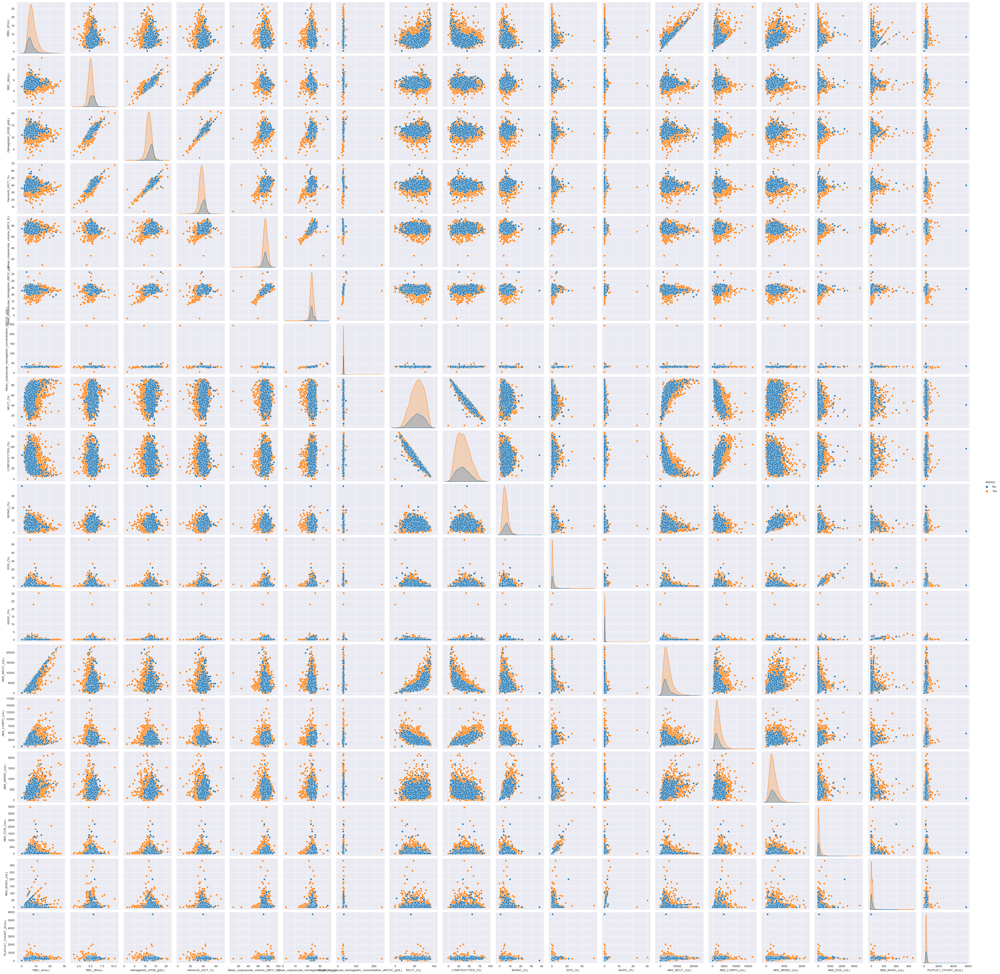

In [24]:
#testing the pairplots for the control vs. irrad

contvirrad_df = solid_monkey_df.copy()
contvirrad_df = contvirrad_df[['IRRAD', 'WBC_(K/uL)', 'RBC_(M/uL)',
       'Hemaglobin_(HGB_g/dL)', 'Hemocrit_(HCT_%)',
       'Mean_corpuscular_volume_(MCV_fL)',
       'Mean_corpuscular_hemaglobin_(MCH_pg)',
       'Mean_corpuscular_hemaglobin_concentration_(MCHC_g/dL)', 'NEUT_(%)',
       'LYMPHOCYTES_(%)', 'MONO_(%)', 'EOS_(%)', 'BASO_(%)', 'ABS_NEUT_(/uL)',
       'ABS_LYMPH_(/uL)', 'ABS_MONO_(/uL)', 'ABS_EOS_(/uL)', 'ABS_BASO_(/uL)',
       'PLATLET_COUNT_(K/uL)']]
#contvirrad_df.head()
#solid_monkey_df.head()




sns.pairplot(contvirrad_df, hue="IRRAD")
plt.show(1)

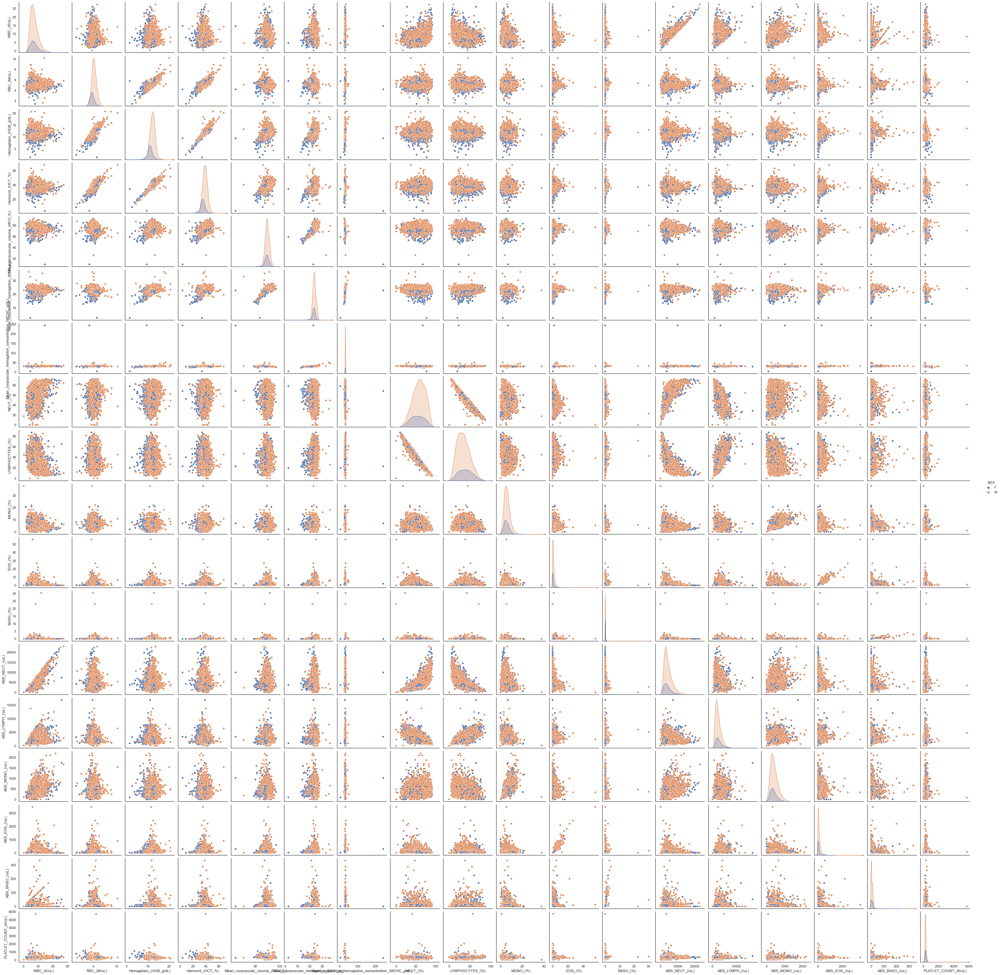

In [275]:
#testing the pairplots for the male v. female
sex_df = solid_monkey_df.copy()
sex_df = sex_df[['SEX', 'WBC_(K/uL)', 'RBC_(M/uL)',
       'Hemaglobin_(HGB_g/dL)', 'Hemocrit_(HCT_%)',
       'Mean_corpuscular_volume_(MCV_fL)',
       'Mean_corpuscular_hemaglobin_(MCH_pg)',
       'Mean_corpuscular_hemaglobin_concentration_(MCHC_g/dL)', 'NEUT_(%)',
       'LYMPHOCYTES_(%)', 'MONO_(%)', 'EOS_(%)', 'BASO_(%)', 'ABS_NEUT_(/uL)',
       'ABS_LYMPH_(/uL)', 'ABS_MONO_(/uL)', 'ABS_EOS_(/uL)', 'ABS_BASO_(/uL)',
       'PLATLET_COUNT_(K/uL)']]
#sex_df.head()


sns.pairplot(sex_df, hue="SEX")
plt.show(1)

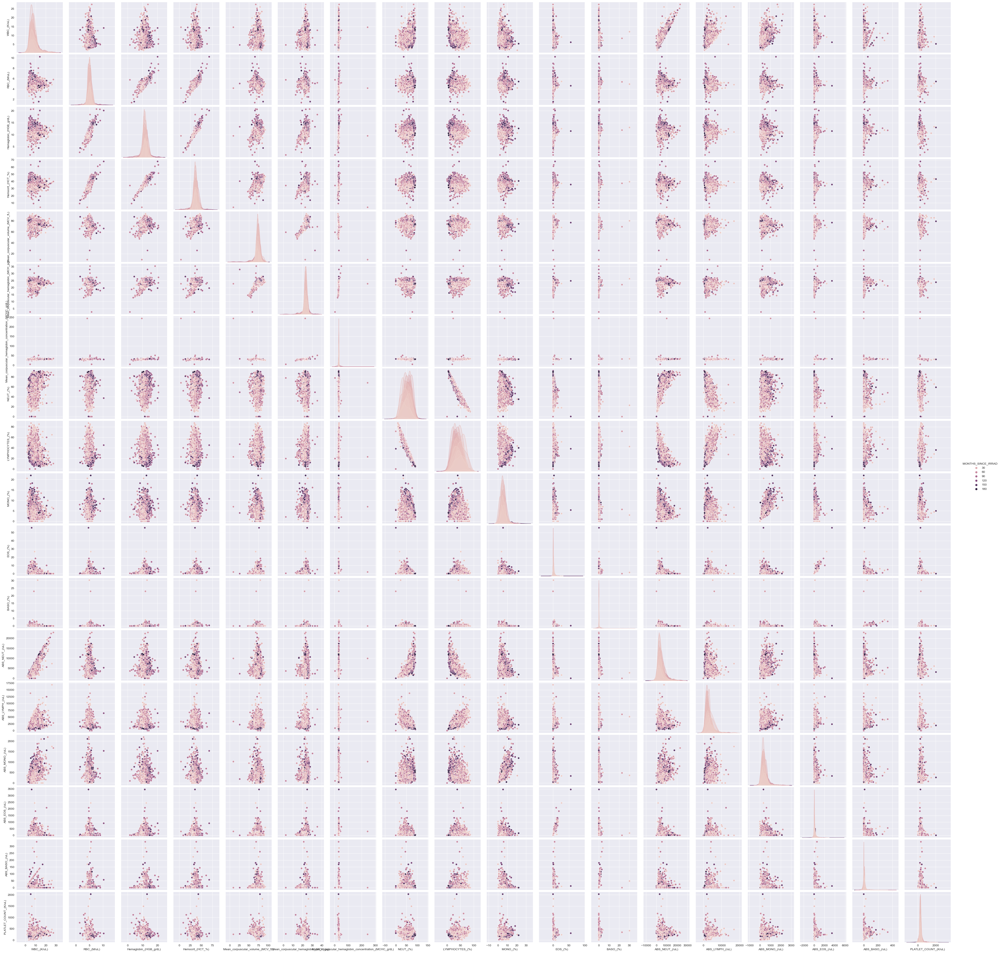

In [44]:
#testing the pairplots for the months since irrad

MSI_df = solid_monkey_df.copy()
MSI_df = MSI_df[['MONTHS_SINCE_IRRAD', 'WBC_(K/uL)', 'RBC_(M/uL)',
       'Hemaglobin_(HGB_g/dL)', 'Hemocrit_(HCT_%)',
       'Mean_corpuscular_volume_(MCV_fL)',
       'Mean_corpuscular_hemaglobin_(MCH_pg)',
       'Mean_corpuscular_hemaglobin_concentration_(MCHC_g/dL)', 'NEUT_(%)',
       'LYMPHOCYTES_(%)', 'MONO_(%)', 'EOS_(%)', 'BASO_(%)', 'ABS_NEUT_(/uL)',
       'ABS_LYMPH_(/uL)', 'ABS_MONO_(/uL)', 'ABS_EOS_(/uL)', 'ABS_BASO_(/uL)',
       'PLATLET_COUNT_(K/uL)']]
#MSI_df.head(1)
#solid_monkey_df.head()



sns.pairplot(MSI_df, hue="MONTHS_SINCE_IRRAD")
plt.show(1)

### Immediately there's no use in visualizing with typical plots that handle only a few variables
 - Viz with UMAP
 - Viz with other high-quantitiy plots
 - Viz with facet grids 

# Machine Learning Magic




## 1.) Can machine learning cluster patterns in monkey response to radiation?



## UMAP
 - Cluster blood analytics
 - Cluster other stuff?
 
See the docs here: https://umap-learn.readthedocs.io/en/latest/index.html



### Blood analytic UMAP
- See all of the blood samples and how they cluster
- cluster for each analytic to see if there is more individualized responses
- cluster each monkey based on all the data

#### Simple UMAP


In [187]:
# Same setup as from the docs example: https://umap-learn.readthedocs.io/en/latest/basic_usage.html
import umap.plot
from sklearn.datasets import load_digits
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
%matplotlib inline
sns.set(style='white', context='notebook', rc={'figure.figsize':(14,10)})

import umap
reducer = umap.UMAP()



print('Setup Complete')

Setup Complete


In [188]:
#need to scale the vales to z-scores to get them all on the same page

#Make df with the blood analytics with no missing values
solid_monkey_df.copy()
blood_monkey_df = solid_monkey_df[['ID','WBC_(K/uL)', 'RBC_(M/uL)',
       'Hemaglobin_(HGB_g/dL)', 'Hemocrit_(HCT_%)',
       'Mean_corpuscular_volume_(MCV_fL)',
       'Mean_corpuscular_hemaglobin_(MCH_pg)',
       'Mean_corpuscular_hemaglobin_concentration_(MCHC_g/dL)', 'NEUT_(%)',
       'LYMPHOCYTES_(%)', 'MONO_(%)', 'EOS_(%)', 'BASO_(%)', 'ABS_NEUT_(/uL)',
       'ABS_LYMPH_(/uL)', 'ABS_MONO_(/uL)', 'ABS_EOS_(/uL)', 'ABS_BASO_(/uL)',
       'PLATLET_COUNT_(K/uL)']].dropna()

#blood_monkey_df.head()

#Scale the blood to z-scores
blood_umap_df = blood_monkey_df[
    [
        'WBC_(K/uL)', 'RBC_(M/uL)',
       'Hemaglobin_(HGB_g/dL)', 'Hemocrit_(HCT_%)',
       'Mean_corpuscular_volume_(MCV_fL)',
       'Mean_corpuscular_hemaglobin_(MCH_pg)',
       'Mean_corpuscular_hemaglobin_concentration_(MCHC_g/dL)', 'NEUT_(%)',
       'LYMPHOCYTES_(%)', 'MONO_(%)', 'EOS_(%)', 'BASO_(%)', 'ABS_NEUT_(/uL)',
       'ABS_LYMPH_(/uL)', 'ABS_MONO_(/uL)', 'ABS_EOS_(/uL)', 'ABS_BASO_(/uL)',
       'PLATLET_COUNT_(K/uL)'
    ]
].values
scaled_blood_df= StandardScaler().fit_transform(blood_umap_df)

In [189]:
# Want it to be (n, 2) for UMAP to work
embedding = reducer.fit_transform(scaled_blood_df)
embedding.shape

(4552, 2)

In [10]:
#Umap needs ID to be an intiger, not str
blood_monkey_df['ID'] = blood_monkey_df['ID'].astype(int)

In [11]:
# For the spiderweb
mapper = umap.UMAP().fit(scaled_blood_df)


Hammer edge bundling is expensive for large graphs!
This may take a long time to compute!


RuntimeError: No mappable was found to use for colorbar creation. First define a mappable such as an image (with imshow) or a contour set (with contourf).

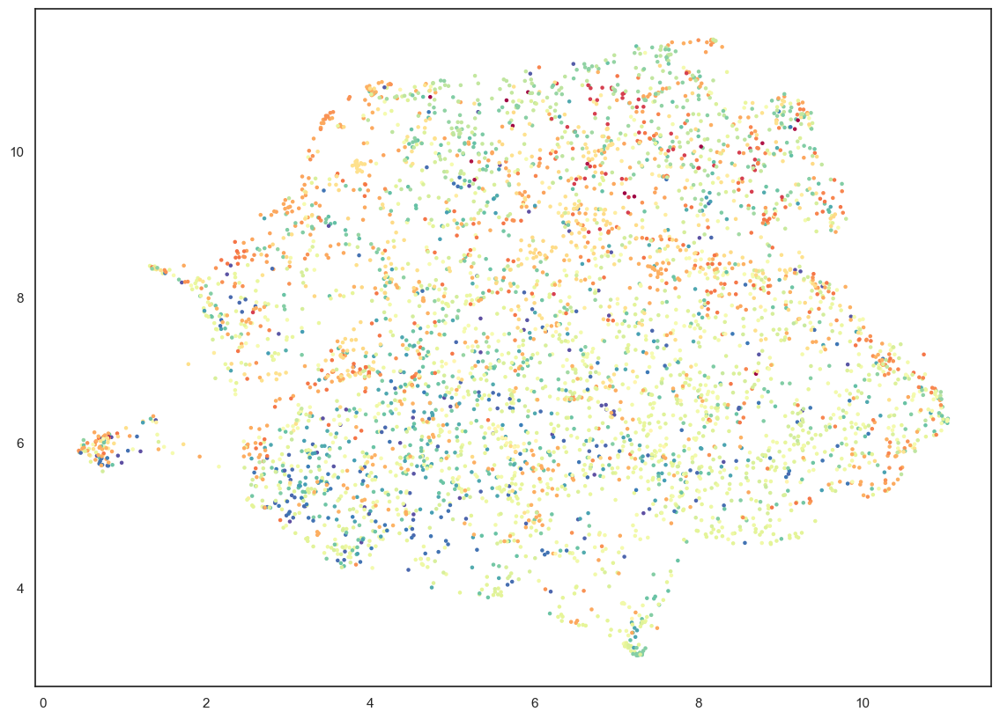

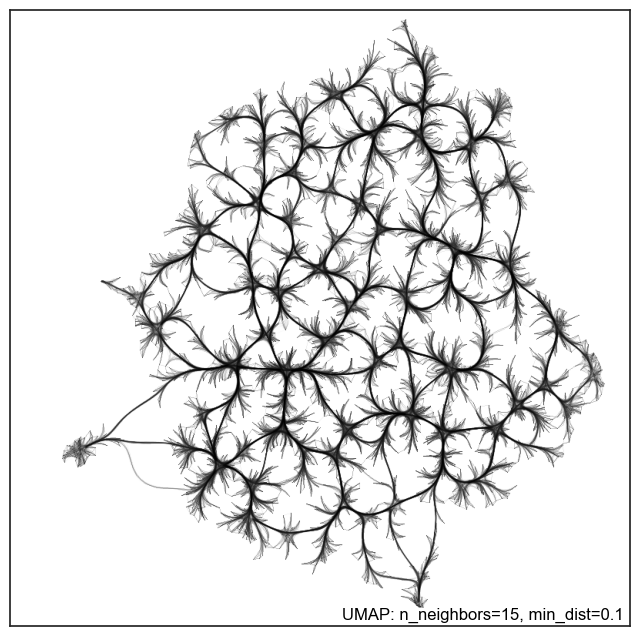

In [80]:
# Simply visualize the UMAP
plt.scatter(embedding[:, 0], 
            embedding[:, 1], 
            c=blood_monkey_df.ID, 
            cmap='Spectral', 
            s=5
           )

#show the spiderweb
#umap.plot.connectivity(mapper, edge_bundling='hammer')

plt.gca().set_aspect('equal', 'datalim')
plt.colorbar(boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.title('ID not a Feature: UMAP projection of the Blood Analytics', fontsize=24);

#### Interactive UMAP to see the ID's for each cluster
- it looks like there are at least three different clusters, we want to know which ones are similar
- also find out how to parse them numerically

In [21]:
from io import BytesIO
from PIL import Image
import base64

In [22]:
def embeddable_image(data):
    img_data = 255 - 15 * data.astype(np.uint8)
    image = Image.fromarray(img_data, mode='L').resize((64, 64), Image.Resampling.BICUBIC)
    buffer = BytesIO()
    image.save(buffer, format='png')
    for_encoding = buffer.getvalue()
    return 'data:image/png;base64,' + base64.b64encode(for_encoding).decode()

In [23]:
import bokeh
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import HoverTool, ColumnDataSource, CategoricalColorMapper
from bokeh.palettes import Spectral10

output_notebook()

Loading BokehJS ...

In [ ]:
umap1_df = pd.DataFrame(embedding, columns=('x', 'y'))

datasource = ColumnDataSource(umap1_df)
color_mapping = CategoricalColorMapper(factors=blood_monkey_df.ID,
                                       palette='Turbo256')




plot_figure = figure(
    title='UMAP projection of the Digits dataset',
    plot_width=600,
    plot_height=600,
    tools=('pan, wheel_zoom, reset')
)

plot_figure.add_tools(HoverTool(tooltips="""
<div>
    <div>
        <img src='@image' style='float: left; margin: 5px 5px 5px 5px'/>
    </div>
    <div>
        <span style='font-size: 16px; color: #224499'>Digit:</span>
        <span style='font-size: 18px'>@digit</span>
    </div>
</div>
"""))

plot_figure.circle(
    'x',
    'y',
    source=datasource,
    color=dict(field='digit', transform=color_mapping),
    line_alpha=0.6,
    fill_alpha=0.6,
    size=4
)
show(plot_figure)

### It works, but the number of points is so large it gives them all grey colors, might work with just monkeys ###

In [ ]:
g = sns.FacetGrid(tips, col="time",  row="sex")
g.map(sns.scatterplot, "total_bill", "tip")

## 2.) Can machine learning make accurate blood analytic predicitons?

### MULTI MONKEY
Following the successful Sinlge monkey pipeline (below)

May need to go to XGBoost, but we shall see

The POOL-ing of data seems to give the model a heartache for some reason



#### Data setup

In [9]:
import os

np.set_printoptions(precision=4)
import catboost as ctb
print('setup complete')


setup complete


In [10]:
solid_monkey_df.tail(2)

,ID,Species,SAMPLE_DATE,IRRAD,IRRAD_DATE,DOB,SEX,TYPE,DAYS_SINCE_IRRAD,MONTHS_SINCE_IRRAD,...,LYMPHOCYTES_(%),MONO_(%),EOS_(%),BASO_(%),ABS_NEUT_(/uL),ABS_LYMPH_(/uL),ABS_MONO_(/uL),ABS_EOS_(/uL),ABS_BASO_(/uL),PLATLET_COUNT_(K/uL)
4550,2210,Rhesus-Indian,2021-09-20 00:00:00,No,NaT,1999-01-01,F,Research,NaN,NaN,...,36.2,10.9,1.7,0.0,2970,2100,632,99,0,348
4551,2210,Rhesus-Indian,2021-10-07 00:00:00,No,NaT,1999-01-01,F,Research,NaN,NaN,...,16.0,21.0,3.0,0.0,3360,896,1176,168,0,329


In [11]:
#make a parent df
solid_monkey_df.copy()
blood_ML_df = solid_monkey_df
blood_ML_df.tail(2)

,ID,Species,SAMPLE_DATE,IRRAD,IRRAD_DATE,DOB,SEX,TYPE,DAYS_SINCE_IRRAD,MONTHS_SINCE_IRRAD,...,LYMPHOCYTES_(%),MONO_(%),EOS_(%),BASO_(%),ABS_NEUT_(/uL),ABS_LYMPH_(/uL),ABS_MONO_(/uL),ABS_EOS_(/uL),ABS_BASO_(/uL),PLATLET_COUNT_(K/uL)
4550,2210,Rhesus-Indian,2021-09-20 00:00:00,No,NaT,1999-01-01,F,Research,NaN,NaN,...,36.2,10.9,1.7,0.0,2970,2100,632,99,0,348
4551,2210,Rhesus-Indian,2021-10-07 00:00:00,No,NaT,1999-01-01,F,Research,NaN,NaN,...,16.0,21.0,3.0,0.0,3360,896,1176,168,0,329


In [12]:
#make train/testdf
(train_df, test_df)= blood_ML_df, blood_ML_df

#train_df.tail(2) 
test_df.tail(2)

,ID,Species,SAMPLE_DATE,IRRAD,IRRAD_DATE,DOB,SEX,TYPE,DAYS_SINCE_IRRAD,MONTHS_SINCE_IRRAD,...,LYMPHOCYTES_(%),MONO_(%),EOS_(%),BASO_(%),ABS_NEUT_(/uL),ABS_LYMPH_(/uL),ABS_MONO_(/uL),ABS_EOS_(/uL),ABS_BASO_(/uL),PLATLET_COUNT_(K/uL)
4550,2210,Rhesus-Indian,2021-09-20 00:00:00,No,NaT,1999-01-01,F,Research,NaN,NaN,...,36.2,10.9,1.7,0.0,2970,2100,632,99,0,348
4551,2210,Rhesus-Indian,2021-10-07 00:00:00,No,NaT,1999-01-01,F,Research,NaN,NaN,...,16.0,21.0,3.0,0.0,3360,896,1176,168,0,329


In [13]:
# label values extraction
#ctb not messing with datetime at the moment
y=train_df['LYMPHOCYTES_(%)']
X=train_df.drop(['ID','IRRAD_DATE','DOB','SAMPLE_DATE','LYMPHOCYTES_(%)'],axis=1)

y.tail()
#X.columns

4547    67.0
4548    56.1
4549    26.8
4550    36.2
4551    16.0
Name: LYMPHOCYTES_(%), dtype: float64

In [14]:
y.to_numpy()

array([48. , 21.4,  8.5, ..., 26.8, 36.2, 16. ])

In [15]:
# Declare catagorical features - firt 0-3 columns 
cat_features= list(range(0,X[X.columns[:4]].shape[1]))

print(cat_features)

# all of our labels are catagorical

[0, 1, 2, 3]


In [16]:
from catboost import Pool
from sklearn.model_selection import train_test_split

#put the data into the pool
pool = Pool(data=X, label=y, cat_features=cat_features)


#train tesr split - 30% test
data= train_test_split(X, y, test_size=0.3, random_state=0)

#### The order of this matters###
X_train, X_validation, y_train, y_validation= data

train_pool = Pool(
    data = X_train,
    label = y_train,
    cat_features = cat_features
)

validation_pool = Pool(
    data = X_validation,
    label = y_validation,
    cat_features = cat_features
)

### for some reason Pool is giving the model a hard time - something about the labels

iteritems is deprecated and will be removed in a future version. Use .items instead.


#### Model Formation

In [ ]:
# Model for lymphocyte predictions without pool
model= CatBoostClassifier(iterations=200,
    learning_rate=0.5,
    loss_function='MultiClass',
    custom_loss=['AUC','Accuracy'],
    early_stopping_rounds=5,
    #use_best_model=True,
    #save_snapshot = True,
    #snapshot_file='monkey_snapshot.bkp',
    #interval is seconds
    #snapshot_interval=120
)


model.fit(X, 
           y, 
           cat_features=cat_features, 
           verbose=100 #tells how many iterations to print
         )

### 800 iterations at 0.5 learn rate took 34.5 hours and got to 0.0256 loss
### 200 iters takes about 9ish hours (the estimate is not correct) and gets 0.236 loss

#### 200 gives very accurate results for predicting lymphocyte %

In [94]:
# saving the model (and my sanity)
model.save_model('catboost_model.bin')
model.save_model('full_monkey_200iter_model.json', format='json')

In [21]:
# loading the pre-saved model
model.load_model('catboost_model.bin')
print(model.get_params())
print(model.learning_rate_)

{'iterations': 200, 'learning_rate': 0.5, 'loss_function': 'MultiClass', 'custom_loss': ['AUC', 'Accuracy'], 'early_stopping_rounds': 5, 'od_wait': 5, 'custom_metric': ['AUC', 'Accuracy'], 'verbose': 100}
0.5


#### Predictions

In [95]:
#Predict the test Lymphocyte percentages

a = model.predict(X_validation)
print(len(a), 
     )
a_df = pd.DataFrame(a)
print(a_df)
print(y_validation)

#Gives very accurate reads with 200 iterations even

1366
              0
0     17.900000
1     36.099998
2     36.000000
3     10.200000
4     61.099998
...         ...
1361  49.000000
1362  39.000000
1363  15.300000
1364  46.400002
1365  44.099998

[1366 rows x 1 columns]
2438    17.9
3343    36.1
1895    36.0
3501    10.2
3256    61.1
        ... 
3878    49.0
3037    39.0
4250    15.3
1770    46.4
2735    44.1
Name: LYMPHOCYTES_(%), Length: 1366, dtype: float64


In [ ]:
from sklearn.metrics import r2_score

#r2 is the best metric for accuracy of predictions with continuous data
print('The r2 score for the model is:',r2_score(y_validation, a_df))

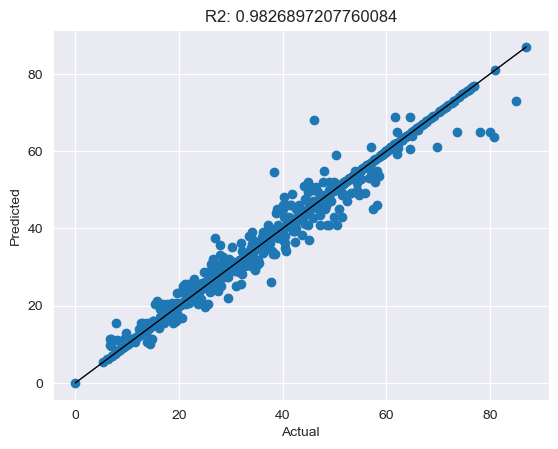

In [133]:
# Visualize the accuracy of the model predictions
fig, ax = plt.subplots()
ax.scatter(y_validation, a_df)


ax.plot([y.min(), y.max()], [y.min(), y.max()], 
        'k-', 
        linewidth=1, 
        markersize=12
)

ax.set_xlabel('Actual Lymphocyte (%)')
ax.set_ylabel('Predicted Lymphocyte (%)')
#regression line
#single_y_validation, single_a_df = single_y_validation.reshape(-1,1), single_a_df.reshape(-1,1)
#ax.plot(single_y_validation, LinearRegression().fit(single_y_validation, single_a_df).predict(single_y_validation))



ax.set_title('R2: ' + str(r2_score(y_validation, a_df)))


plt.show()

#### Feature analysis

In [ ]:
from catboost import EFstrType

# Get the feature importances for lymphocyte predictions
model.get_feature_importance(data=pool,
                       #reference_data=None,
                       #type=EFstrType.ShapValues,
                       prettified=True,
                       #thread_count=-1,
                       #verbose=False,
                       #log_cout=sys.stdout,
                       #log_cerr=sys.stderr
)


### I wonder if iRRAD is 0 because all of the test was irrad monkeys?

### SINGLE MONKEY 

#### Data Setup

In [10]:
#make a parent df
single_monkey_df.copy()
single_blood_ML_df = single_monkey_df
single_blood_ML_df.tail(2)

,ID,Species,SAMPLE_DATE,IRRAD,IRRAD_DATE,DOB,SEX,TYPE,DAYS_SINCE_IRRAD,MONTHS_SINCE_IRRAD,...,LYMPHOCYTES_(%),MONO_(%),EOS_(%),BASO_(%),ABS_NEUT_(/uL),ABS_LYMPH_(/uL),ABS_MONO_(/uL),ABS_EOS_(/uL),ABS_BASO_(/uL),PLATLET_COUNT_(K/uL)
49,2046,Rhesus-Chinese,2021-04-22 00:00:00,Yes,2014-04-09,2007-07-03,F,Clinical,2570.0,84.0,...,58.3,4.3,0.2,0.3,3247,5130,378,18,26,306
50,2046,Rhesus-Chinese,2021-10-07 00:00:00,Yes,2014-04-09,2007-07-03,F,Research,2738.0,90.0,...,52.8,0.9,0.3,0.1,3387,3897,66,22,7,255


In [11]:
#make train/testdf
(single_train_df, single_test_df)= single_blood_ML_df, single_blood_ML_df

#single_train_df.tail(2) 
single_test_df.tail(2)

,ID,Species,SAMPLE_DATE,IRRAD,IRRAD_DATE,DOB,SEX,TYPE,DAYS_SINCE_IRRAD,MONTHS_SINCE_IRRAD,...,LYMPHOCYTES_(%),MONO_(%),EOS_(%),BASO_(%),ABS_NEUT_(/uL),ABS_LYMPH_(/uL),ABS_MONO_(/uL),ABS_EOS_(/uL),ABS_BASO_(/uL),PLATLET_COUNT_(K/uL)
49,2046,Rhesus-Chinese,2021-04-22 00:00:00,Yes,2014-04-09,2007-07-03,F,Clinical,2570.0,84.0,...,58.3,4.3,0.2,0.3,3247,5130,378,18,26,306
50,2046,Rhesus-Chinese,2021-10-07 00:00:00,Yes,2014-04-09,2007-07-03,F,Research,2738.0,90.0,...,52.8,0.9,0.3,0.1,3387,3897,66,22,7,255


In [12]:
# label values extraction
#ctb not messing with datetime at the moment
single_y=single_train_df['LYMPHOCYTES_(%)']
single_X=single_train_df.drop(['ID','IRRAD_DATE','DOB','SAMPLE_DATE','LYMPHOCYTES_(%)'],axis=1)

single_y.tail()
#single_X.columns

46    13.2
47    38.2
48    45.0
49    58.3
50    52.8
Name: LYMPHOCYTES_(%), dtype: float64

In [13]:
single_y.to_numpy()

array([44.6, 40.5, 39.9, 46.8, 22.8, 23.3, 35.1, 20.6, 21.8, 42.3, 20.1,
       19.8, 53.1, 13.2, 38.2, 45. , 58.3, 52.8])

In [14]:
# Declare catagorical features - firt 0-3 columns 
single_cat_features= list(range(0,single_X[single_X.columns[:4]].shape[1]))

print(single_cat_features)

# all of our labels are catagorical

[0, 1, 2, 3]


In [15]:
from catboost import Pool
from sklearn.model_selection import train_test_split

#put the data into the pool
single_pool = Pool(data=single_X, label=single_y, cat_features=single_cat_features)


#train tesr split - 30% test
single_data= train_test_split(single_X, single_y, test_size=0.3, random_state=0)

#### The order of this matters###
single_X_train, single_X_validation, single_y_train, single_y_validation= single_data

single_train_pool = Pool(
    data = single_X_train,
    label = single_y_train,
    cat_features = single_cat_features
)

single_validation_pool = Pool(
    data = single_X_validation,
    label = single_y_validation,
    cat_features = single_cat_features
)

iteritems is deprecated and will be removed in a future version. Use .items instead.


#### Model Formation

In [16]:
from catboost import CatBoostClassifier
# Model for predicting lymphocyte counts for a singel monkey
model6= CatBoostClassifier(iterations=1000,
    learning_rate=0.5,
    loss_function='MultiClass',
    custom_loss=['AUC','Accuracy'],
    early_stopping_rounds=5,
    #use_best_model=True,
    #save_snapshot = True,
    #snapshot_file='monkey_snapshot.bkp',
    #interval is seconds
    #snapshot_interval=120
)


model6.fit(single_X, 
           single_y, 
           cat_features=single_cat_features, 
           verbose=100 #tells how many iterations to print
         )

0:	learn: 2.7560810	total: 63.7ms	remaining: 1m 3s
100:	learn: 0.1138154	total: 233ms	remaining: 2.08s
200:	learn: 0.0470003	total: 413ms	remaining: 1.64s
300:	learn: 0.0291512	total: 568ms	remaining: 1.32s
400:	learn: 0.0209227	total: 736ms	remaining: 1.1s
500:	learn: 0.0163116	total: 885ms	remaining: 881ms
600:	learn: 0.0133293	total: 1.05s	remaining: 697ms
700:	learn: 0.0112926	total: 1.24s	remaining: 528ms
800:	learn: 0.0097762	total: 1.41s	remaining: 349ms
900:	learn: 0.0086191	total: 1.56s	remaining: 171ms
999:	learn: 0.0077237	total: 1.72s	remaining: 0us


#### Predictions

In [17]:
#Predict the test Lymphocyte percentages

single_a = model6.predict(single_X_validation)
print(len(single_a), 
     )
single_a_df = pd.DataFrame(single_a)
print(single_a_df)
print(single_y_validation)

#Gives very accurate reads with 100 iterations even

6
           0
0  40.500000
1  35.099998
2  21.799999
3  20.100000
4  38.200001
5  22.799999
34    40.5
39    35.1
41    21.8
43    20.1
47    38.2
37    22.8
Name: LYMPHOCYTES_(%), dtype: float64


In [21]:
#r2 is the best metric for accuracy of predictions with continuous data
print('The r2 score for the model is:',r2_score(single_y_validation, single_a_df))


The r2 score for the model is: 0.99999999999999


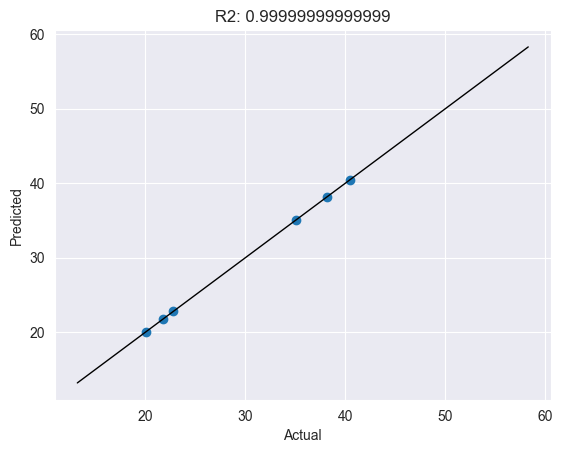

In [22]:
# Plot the predictions vs. actual with the R2 score

fig, ax = plt.subplots()
ax.scatter(single_y_validation, single_a_df)


ax.plot([single_y.min(), single_y.max()], [single_y.min(), single_y.max()], 
        'k-', 
        linewidth=1, 
        markersize=120
)

ax.set_xlabel('Actual Lymphocyte (%)')
ax.set_ylabel('Predicted Lymphocyte (%)')
#regression line
#single_y_validation, single_a_df = single_y_validation.reshape(-1,1), single_a_df.reshape(-1,1)
#ax.plot(single_y_validation, LinearRegression().fit(single_y_validation, single_a_df).predict(single_y_validation))



ax.set_title('R2: ' + str(r2_score(single_y_validation, single_a_df)))


plt.show()

#### Feature Analysis

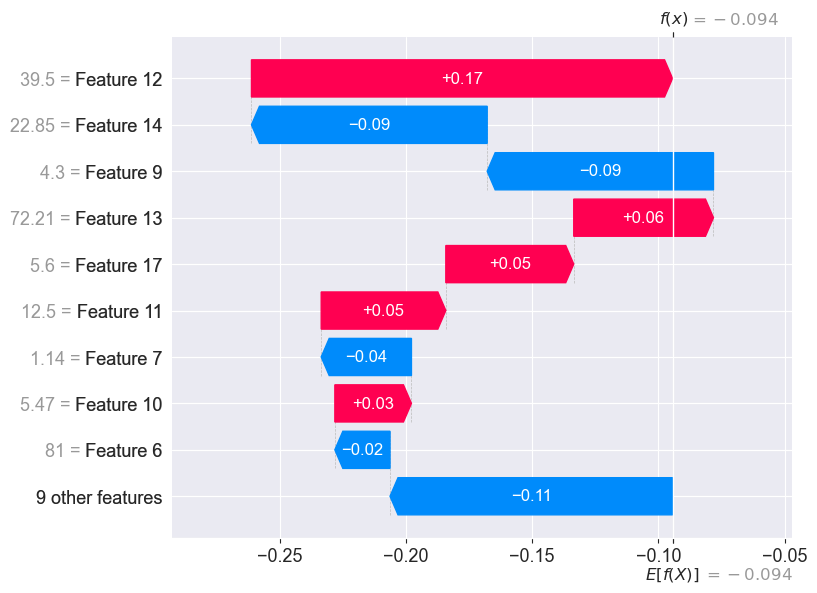

In [68]:
#gives the feature importance for a single output prediciton from the model
#see if I can loop it to see all of them, or is there is a "in general" plot/calculation
explainer = shap.Explainer(model6)
shap_values = explainer(single_X)

idx = 3
exp = shap.Explanation(shap_values.values[0], shap_values.base_values[0][0], shap_values.data)
shap.plots.waterfall(exp[idx])


# Pretty consistently Hemocrit (%) is the most influential

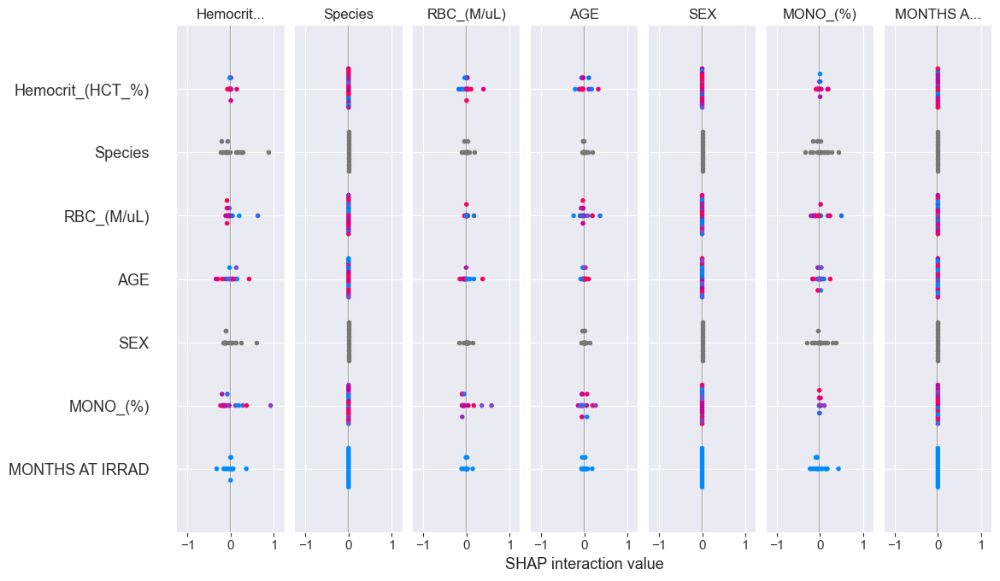

In [72]:
#gives the feature importance for a single output prediciton from the model
#see if I can loop it to see all of them, or is there is a "in general" plot/calculation
explainer = shap.Explainer(model6)
shap_values = explainer(single_X)

#idx = 3
exp = shap.Explanation(shap_values.values[0], shap_values.base_values[0][0], shap_values.data)
#shap.plots.waterfall(exp[idx], feature_names = single_X.columns)
shap.summary_plot(shap_values, single_X, feature_names = single_X.columns)

# very intersting output

In [156]:
# Find the feature importance for predicting the lmphocyte counts is a single monkey
model.get_feature_importance(data=single_pool,
                       #reference_data=None,
                       #type=EFstrType.ShapValues,
                       prettified=True,
                       #thread_count=-1,
                       #verbose=False,
                       #log_cout=sys.stdout,
                       #log_cerr=sys.stderr
)

### The IRRAD is last because all the samples had the same IRRAD status

,Feature Id,Importances
0,NEUT_(%),37.377225
1,MONO_(%),8.222051
2,TYPE,7.969498
3,ABS_NEUT_(/uL),5.815226
4,ABS_MONO_(/uL),5.495224
5,ABS_LYMPH_(/uL),5.013113
6,PLATLET_COUNT_(K/uL),3.531235
7,WBC_(K/uL),3.480177
8,Mean_corpuscular_hemaglobin_concentration_(MCH...,3.340364
9,Hemocrit_(HCT_%),2.963456


### Summary & Elaborations
It apprears that ML can predict the Lymphocyte % of the monkeys with high accuracy both on a single and multi-monkey basis. It also appears that Irradiation (IRRAD) has no importance on these predictions, which is consistent with the preliminary data analyses. 

Following this:
- I will impliment proprietary federated learning methods to validate and hopefully make even more impactful
- Test with other blood analytics, perhaps looping through all of them
- Find better ways to represent and validate the findings 
- Test out forcasting

## 3.) Can machine learning predict the health statuses of the monkeys?

- Might be useful to see when the maladies (i.e. age of malady) occured

- Might be cool to do a NLP for the notes at some point

- Look at w/o biomarkers and w/ biomarkers

- See if I can predict the "animal status" - living=1/dead=0

- Start with simple binary classification - did this monkey have ____ malady (yes=1, no=0)



### Data Processing

In [50]:
#Makee a df were all the data is present (except irrad data for the controls)
health_monkey_df = pd.read_excel('../Documents/demographic_data_r2.xlsx',
                    sheet_name=1,
                    skiprows = 0,
                    #usecols = ,
                    engine = 'openpyxl',
                    date_parser=parser
                         )

#Set the index to the monkey ID and make the labels not read as integers
#health_monkey_df.set_index(['ID'])
#health_monkey_df['ID'] = health_monkey_df['ID'].astype(str)

#health_monkey_df.columns
health_monkey_df.head(10)

,ID,Time_Under_Observation_(yrs),Dose_(Gy),Irrad_Age_(months),Years_Since_Irrad,Current_Age_(years),Animal_Status,Diabetes_(Y/N),Cataracts_(Y/N),Arthritis_(Y/N),...,Hypertension_(Y/N),Testicular Atrophy_(Y/N),Ovarian Dysfunction_(Y/N),Hepatic_(Y/N),Kidney_(Y/N),Lung_(Y/N),Bone_(Y/N),Overweight_(Y/N),Underweight_(Y/N),Brain Lesion_(Y/N)
0,1423,1.380822,0.00,NaN,NaN,9.947945,DECEASED,NaN,Y,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Y,NaN,NaN
1,1484,11.868493,0.00,NaN,NaN,19.276712,LIVING,NaN,Y,Y,...,NaN,NaN,NaN,NaN,NaN,Y,NaN,Y,NaN,NaN
2,1574,13.030137,7.55,52.9,13.358904,17.767123,DECEASED,NaN,NaN,Y,...,NaN,NaN,NaN,NaN,Y,NaN,NaN,NaN,NaN,Y
3,1575,14.139726,7.85,40.2,14.372603,17.726027,DECEASED,NaN,Y,Y,...,Y,Y,NaN,NaN,Y,Y,NaN,NaN,NaN,Y
4,1576,6.394521,8.05,51.4,6.723288,11.005479,DECEASED,NaN,Y,NaN,...,NaN,Y,NaN,NaN,NaN,NaN,NaN,Y,NaN,NaN
5,1577,12.109589,7.55,37.0,12.438356,15.520548,DECEASED,Y,Y,Y,...,Y,Y,NaN,NaN,Y,NaN,NaN,Y,NaN,Y
6,1578,11.682192,7.20,39.4,12.010959,15.295890,DECEASED,NaN,Y,Y,...,NaN,Y,NaN,NaN,NaN,NaN,NaN,NaN,Y,NaN
7,1597,15.501370,8.40,52.9,15.868493,20.273973,LIVING,NaN,Y,NaN,...,Y,Y,NaN,NaN,Y,Y,NaN,NaN,NaN,Y
8,1611,11.712329,7.55,46.4,12.090411,15.961644,DECEASED,NaN,NaN,NaN,...,Y,Y,NaN,NaN,Y,Y,NaN,NaN,NaN,NaN
9,1612,11.846575,6.75,84.2,12.147945,19.161644,DECEASED,Y,NaN,Y,...,Y,Y,NaN,Y,Y,Y,NaN,Y,NaN,NaN


In [226]:
# Turn the Y/N to 1/0 and LIVING/DECESED to 1/0
#copy over the OG df
mod_health_monkey_df = health_monkey_df.copy()

# Y to 1
# For some reason, multiple columns together is seen as a df and .map() doesn't work
# Need to do the .map() before the .fillna()
mod_health_monkey_df['Diabetes_(Y/N)'] = mod_health_monkey_df['Diabetes_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Cataracts_(Y/N)'] = mod_health_monkey_df['Cataracts_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Arthritis_(Y/N)'] = mod_health_monkey_df['Arthritis_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Periodontitis_(Y/N)'] = mod_health_monkey_df['Periodontitis_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['GI_(Y/N)'] = mod_health_monkey_df['GI_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Behavior_(Y/N)'] = mod_health_monkey_df['Behavior_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Tumor_(Y/N)'] = mod_health_monkey_df['Tumor_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Heart_(Y/N)'] = mod_health_monkey_df['Heart_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Hypertension_(Y/N)'] = mod_health_monkey_df['Hypertension_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Testicular Atrophy_(Y/N)'] = mod_health_monkey_df['Testicular Atrophy_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Ovarian Dysfunction_(Y/N)'] = mod_health_monkey_df['Ovarian Dysfunction_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Hepatic_(Y/N)'] = mod_health_monkey_df['Hepatic_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Kidney_(Y/N)'] = mod_health_monkey_df['Kidney_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Lung_(Y/N)'] = mod_health_monkey_df['Lung_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Bone_(Y/N)'] = mod_health_monkey_df['Bone_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Overweight_(Y/N)'] = mod_health_monkey_df['Overweight_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Underweight_(Y/N)'] = mod_health_monkey_df['Underweight_(Y/N)'].map({'Y': 1})
mod_health_monkey_df['Brain Lesion_(Y/N)'] = mod_health_monkey_df['Brain Lesion_(Y/N)'].map({'Y': 1})


# NaN to 0
mod_health_monkey_df[['Diabetes_(Y/N)', 'Cataracts_(Y/N)', 'Arthritis_(Y/N)',
       'Periodontitis_(Y/N)', 'GI_(Y/N)', 'Behavior_(Y/N)', 'Tumor_(Y/N)',
       'Heart_(Y/N)', 'Hypertension_(Y/N)', 'Testicular Atrophy_(Y/N)',
       'Ovarian Dysfunction_(Y/N)', 'Hepatic_(Y/N)', 'Kidney_(Y/N)',
       'Lung_(Y/N)', 'Bone_(Y/N)', 'Overweight_(Y/N)', 'Underweight_(Y/N)',
       'Brain Lesion_(Y/N)']]= mod_health_monkey_df[['Diabetes_(Y/N)', 'Cataracts_(Y/N)', 'Arthritis_(Y/N)',
       'Periodontitis_(Y/N)', 'GI_(Y/N)', 'Behavior_(Y/N)', 'Tumor_(Y/N)',
       'Heart_(Y/N)', 'Hypertension_(Y/N)', 'Testicular Atrophy_(Y/N)',
       'Ovarian Dysfunction_(Y/N)', 'Hepatic_(Y/N)', 'Kidney_(Y/N)',
       'Lung_(Y/N)', 'Bone_(Y/N)', 'Overweight_(Y/N)', 'Underweight_(Y/N)',
       'Brain Lesion_(Y/N)']].fillna(0, #inplace=True
)

#LIVING/DECESED to 1/0
mod_health_monkey_df['Animal_Status'] = mod_health_monkey_df['Animal_Status'].map({'LIVING':1, 'DECEASED': 0})


mod_health_monkey_df.head(10)

,ID,Time_Under_Observation_(yrs),Dose_(Gy),Irrad_Age_(months),Years_Since_Irrad,Current_Age_(years),Animal_Status,Diabetes_(Y/N),Cataracts_(Y/N),Arthritis_(Y/N),...,Hypertension_(Y/N),Testicular Atrophy_(Y/N),Ovarian Dysfunction_(Y/N),Hepatic_(Y/N),Kidney_(Y/N),Lung_(Y/N),Bone_(Y/N),Overweight_(Y/N),Underweight_(Y/N),Brain Lesion_(Y/N)
0,1423,1.380822,0.00,NaN,NaN,9.947945,0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,1484,11.868493,0.00,NaN,NaN,19.276712,1,0.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
2,1574,13.030137,7.55,52.9,13.358904,17.767123,0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
3,1575,14.139726,7.85,40.2,14.372603,17.726027,0,0.0,1.0,1.0,...,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0
4,1576,6.394521,8.05,51.4,6.723288,11.005479,0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
5,1577,12.109589,7.55,37.0,12.438356,15.520548,0,1.0,0.0,1.0,...,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0
6,1578,11.682192,7.20,39.4,12.010959,15.295890,0,0.0,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
7,1597,15.501370,8.40,52.9,15.868493,20.273973,1,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0
8,1611,11.712329,7.55,46.4,12.090411,15.961644,0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
9,1612,11.846575,6.75,84.2,12.147945,19.161644,0,1.0,0.0,1.0,...,0.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0


### Predicting a health outcome
- start with tumors because it's relevent, but then see if brain lesion because it's cool and more rare

#### Data setup

In [228]:
#make a parent df
mod_health_monkey_df.copy()
health_ML_df = mod_health_monkey_df
health_ML_df.tail(2)

,ID,Time_Under_Observation_(yrs),Dose_(Gy),Irrad_Age_(months),Years_Since_Irrad,Current_Age_(years),Animal_Status,Diabetes_(Y/N),Cataracts_(Y/N),Arthritis_(Y/N),...,Hypertension_(Y/N),Testicular Atrophy_(Y/N),Ovarian Dysfunction_(Y/N),Hepatic_(Y/N),Kidney_(Y/N),Lung_(Y/N),Bone_(Y/N),Overweight_(Y/N),Underweight_(Y/N),Brain Lesion_(Y/N)
150,2094,3.621918,5.5,52.1,4.473973,8.813699,1,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
151,2103,3.621918,5.5,53.4,4.473973,8.920548,1,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [229]:
#make train/testdf
(health_train_df, health_test_df)= health_ML_df, health_ML_df

health_test_df.tail(2)

,ID,Time_Under_Observation_(yrs),Dose_(Gy),Irrad_Age_(months),Years_Since_Irrad,Current_Age_(years),Animal_Status,Diabetes_(Y/N),Cataracts_(Y/N),Arthritis_(Y/N),...,Hypertension_(Y/N),Testicular Atrophy_(Y/N),Ovarian Dysfunction_(Y/N),Hepatic_(Y/N),Kidney_(Y/N),Lung_(Y/N),Bone_(Y/N),Overweight_(Y/N),Underweight_(Y/N),Brain Lesion_(Y/N)
150,2094,3.621918,5.5,52.1,4.473973,8.813699,1,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
151,2103,3.621918,5.5,53.4,4.473973,8.920548,1,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [230]:
# label values extraction
health_y=health_train_df['Tumor_(Y/N)']
health_X=health_train_df.drop(['Tumor_(Y/N)'],axis=1)

health_y.tail()
#health_X.columns

147    0.0
148    0.0
149    0.0
150    0.0
151    0.0
Name: Tumor_(Y/N), dtype: float64

In [231]:
y.to_numpy()

array([48. , 21.4,  8.5, ..., 26.8, 36.2, 16. ])

In [240]:
# Declare catagorical features - first column
cat_features= list(range(0,health_X[health_X.columns[:1]].shape[1]))

print(cat_features)

# all of our labels are catagorical

[0]


In [241]:
#put the data into the pool
health_pool = Pool(data=health_X, label=health_y, cat_features=cat_features)


#train tesr split - 30% test
health_data= train_test_split(health_X, health_y, test_size=0.3, random_state=0)

#### The order of this matters###
health_X_train, health_X_validation, health_y_train, health_y_validation= health_data

health_train_pool = Pool(
    data = health_X_train,
    label = health_y_train,
    cat_features = cat_features
)

health_validation_pool = Pool(
    data = health_X_validation,
    label = health_y_validation,
    cat_features = cat_features
)


iteritems is deprecated and will be removed in a future version. Use .items instead.


#### Model Formation

In [246]:
# Model for Tumor occurance 
# loss_function = logloss becuase it's binary
health_model= CatBoostClassifier(iterations=2000,
    learning_rate=0.5,
    loss_function='Logloss',
    custom_loss=['AUC','Accuracy'],
    early_stopping_rounds=5,
    #use_best_model=True,
    #save_snapshot = True,
    #snapshot_file='monkey_snapshot.bkp',
    #interval is seconds
    #snapshot_interval=120
)


health_model.fit(health_X, 
           health_y, 
           cat_features=cat_features, 
           verbose=500 #tells how many iterations to print
         )

### 2000 iters takes 6.7 secs and gives 0.0004025 loss

0:	learn: 0.3399817	total: 3.37ms	remaining: 6.73s
500:	learn: 0.0007631	total: 760ms	remaining: 2.27s
1000:	learn: 0.0005454	total: 1.46s	remaining: 1.46s
1500:	learn: 0.0004500	total: 2.15s	remaining: 715ms
1999:	learn: 0.0004025	total: 2.84s	remaining: 0us


#### Predicitions

In [247]:
#Predict the test occurence of tumors

health_a = health_model.predict(health_X_validation)
print(len(health_a), 
     )
health_a_df = pd.DataFrame(health_a)
print(health_a_df)
print(health_y_validation)

#Gives very accurate reads with 200 iterations even

46
      0
0   0.0
1   0.0
2   0.0
3   0.0
4   0.0
5   0.0
6   0.0
7   1.0
8   0.0
9   0.0
10  0.0
11  0.0
12  0.0
13  0.0
14  0.0
15  0.0
16  0.0
17  0.0
18  0.0
19  0.0
20  0.0
21  0.0
22  0.0
23  0.0
24  0.0
25  0.0
26  1.0
27  0.0
28  0.0
29  0.0
30  0.0
31  0.0
32  0.0
33  1.0
34  0.0
35  0.0
36  0.0
37  0.0
38  0.0
39  0.0
40  0.0
41  0.0
42  0.0
43  0.0
44  0.0
45  0.0
98     0.0
44     0.0
62     0.0
24     0.0
102    0.0
37     0.0
83     0.0
7      1.0
113    0.0
51     0.0
40     0.0
127    0.0
133    0.0
26     0.0
101    0.0
149    0.0
108    0.0
54     0.0
109    0.0
33     0.0
136    0.0
61     0.0
128    0.0
135    0.0
125    0.0
63     0.0
16     1.0
122    0.0
45     0.0
95     0.0
8      0.0
89     0.0
22     0.0
84     1.0
94     0.0
85     0.0
27     0.0
100    0.0
73     0.0
134    0.0
18     0.0
91     0.0
30     0.0
66     0.0
56     0.0
2      0.0
Name: Tumor_(Y/N), dtype: float64


In [ ]:
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm = confusion_matrix(health_y_validation, health_a_df)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              #display_labels=clf.classes_
                             )
disp.plot()
plt.show()

In [259]:
# One metric of accuracy and precision
from sklearn import metrics

Accuracy = metrics.accuracy_score(health_y_validation, health_a_df)
Precision = metrics.precision_score(health_y_validation, health_a_df)

print('Accuracy:',Accuracy, 'Precision:',Precision)


Accuracy: 1.0 Precision: 1.0


In [263]:
# A better metric for accuracy and precision
from sklearn.metrics import classification_report

print(classification_report(health_y_validation, health_a_df))

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00        43
         1.0       1.00      1.00      1.00         3

    accuracy                           1.00        46
   macro avg       1.00      1.00      1.00        46
weighted avg       1.00      1.00      1.00        46



#### Feature Analysis

In [264]:
from catboost import EFstrType

# Get the feature importances for tumor predictions
health_model.get_feature_importance(data=health_pool,
                       #reference_data=None,
                       #type=EFstrType.ShapValues,
                       prettified=True,
                       #thread_count=-1,
                       #verbose=False,
                       #log_cout=sys.stdout,
                       #log_cerr=sys.stderr
)


### That's expected, radiation-related and age-related seem to be the highest effectors 

,Feature Id,Importances
0,Dose_(Gy),14.984810
1,Heart_(Y/N),14.908153
2,Time_Under_Observation_(yrs),13.851867
3,Overweight_(Y/N),11.484527
4,Years_Since_Irrad,11.038610
5,Diabetes_(Y/N),8.652713
6,Current_Age_(years),8.556178
7,Irrad_Age_(months),6.862073
8,Hepatic_(Y/N),2.628208
9,Testicular Atrophy_(Y/N),2.283980


#### Summary
It appears that the model can classify if a monkey would have developed a tumor with extremely high accuracy
- Try to predict when the tumors will occur, add more data

### Predicting living or dead

#### Data setup

In [268]:
#make a parent df
mod_health_monkey_df.copy()
dead_ML_df = mod_health_monkey_df
#dead_ML_df.tail(2)

#make train/testdf
(dead_train_df, dead_test_df)= dead_ML_df, dead_ML_df

#dead_test_df.tail(2)

# label values extraction
dead_y=dead_train_df['Animal_Status']
dead_X=dead_train_df.drop(['Animal_Status'],axis=1)

#dead_y.tail()
#dead_X.columns

#dead_y.to_numpy()

# Declare catagorical features - first column
cat_features= list(range(0,dead_X[dead_X.columns[:1]].shape[1]))

print(cat_features)

# all of our labels are catagorical

[0]


In [269]:
#put the data into the pool
dead_pool = Pool(data=dead_X, label=dead_y, cat_features=cat_features)


#train tesr split - 30% test
dead_data= train_test_split(dead_X, dead_y, test_size=0.3, random_state=0)

#### The order of this matters###
dead_X_train, dead_X_validation, dead_y_train, dead_y_validation= dead_data

dead_train_pool = Pool(
    data = dead_X_train,
    label = dead_y_train,
    cat_features = cat_features
)

dead_validation_pool = Pool(
    data = dead_X_validation,
    label = dead_y_validation,
    cat_features = cat_features
)


iteritems is deprecated and will be removed in a future version. Use .items instead.


#### Model Formation

In [270]:
# Model for Tumor occurance 
# loss_function = logloss becuase it's binary
dead_model= CatBoostClassifier(iterations=2000,
    learning_rate=0.5,
    loss_function='Logloss',
    custom_loss=['AUC','Accuracy'],
    early_stopping_rounds=5,
    #use_best_model=True,
    #save_snapshot = True,
    #snapshot_file='monkey_snapshot.bkp',
    #interval is seconds
    #snapshot_interval=120
)


dead_model.fit(dead_X, 
           dead_y, 
           cat_features=cat_features, 
           verbose=500 #tells how many iterations to print
         )

### 2000 iters takes 3.02 secs and gives 0.0008993 loss

0:	learn: 0.4666260	total: 3.66ms	remaining: 7.33s
500:	learn: 0.0012898	total: 820ms	remaining: 2.45s
1000:	learn: 0.0010898	total: 1.56s	remaining: 1.55s
1500:	learn: 0.0009804	total: 2.28s	remaining: 758ms
1999:	learn: 0.0008993	total: 3.02s	remaining: 0us


#### Predicitions

In [271]:
#Predict the test occurence of tumors

dead_a = dead_model.predict(dead_X_validation)
print(len(dead_a), 
     )
dead_a_df = pd.DataFrame(dead_a)
print(dead_a_df)
print(dead_y_validation)

#Gives very accurate reads with 200 iterations even

46
    0
0   1
1   0
2   1
3   1
4   1
5   0
6   1
7   1
8   1
9   1
10  0
11  0
12  0
13  0
14  0
15  1
16  0
17  1
18  1
19  0
20  1
21  0
22  1
23  0
24  0
25  1
26  0
27  1
28  0
29  0
30  0
31  1
32  0
33  0
34  1
35  1
36  0
37  1
38  1
39  0
40  0
41  1
42  0
43  0
44  1
45  0
98     1
44     0
62     1
24     1
102    1
37     0
83     1
7      1
113    1
51     1
40     0
127    0
133    0
26     0
101    0
149    1
108    0
54     1
109    1
33     0
136    1
61     0
128    1
135    0
125    0
63     1
16     0
122    1
45     0
95     0
8      0
89     1
22     0
84     0
94     1
85     1
27     0
100    1
73     1
134    0
18     0
91     1
30     0
66     0
56     1
2      0
Name: Animal_Status, dtype: int64


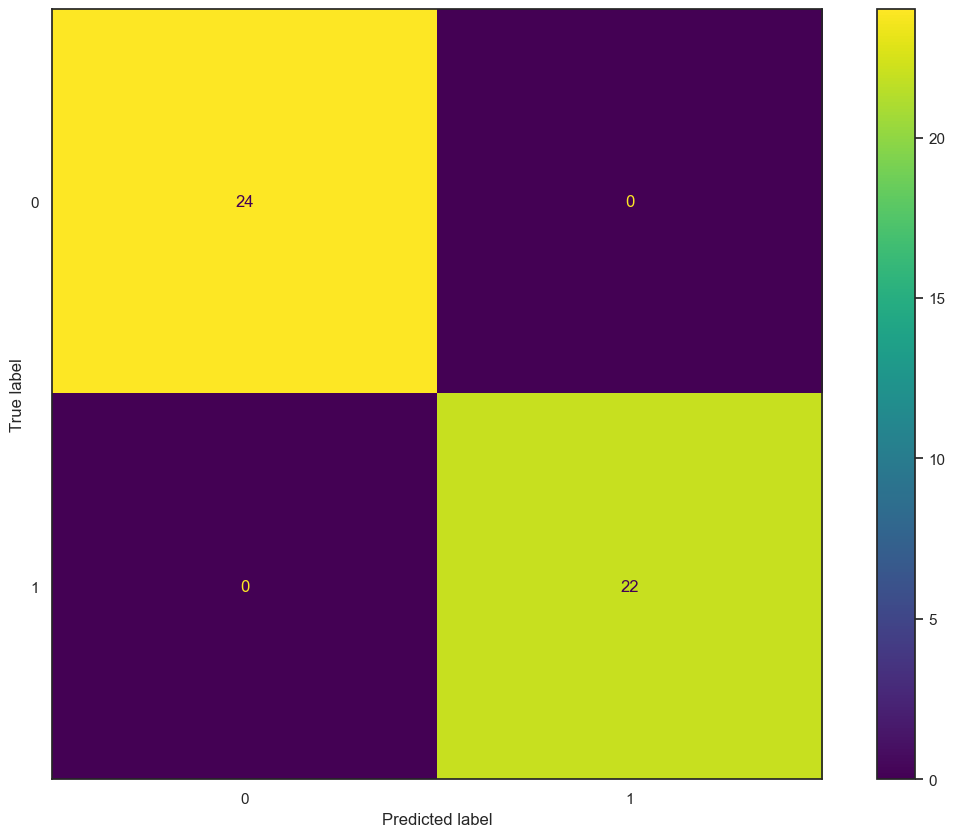

In [272]:
# Make a confusion matrix, it's the best accuracy metric for binary class.
cm = confusion_matrix(dead_y_validation, dead_a_df)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              #display_labels=clf.classes_
                             )
disp.plot()
plt.show()

In [273]:
from sklearn.metrics import classification_report
Accuracy = metrics.accuracy_score(dead_y_validation, dead_a_df)
Precision = metrics.precision_score(dead_y_validation, dead_a_df)

print('Accuracy:',Accuracy, 'Precision:',Precision)


print(classification_report(dead_y_validation, dead_a_df))

Accuracy: 1.0 Precision: 1.0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        24
           1       1.00      1.00      1.00        22

    accuracy                           1.00        46
   macro avg       1.00      1.00      1.00        46
weighted avg       1.00      1.00      1.00        46



#### Feature Analysis

In [274]:
# Get the feature importances for dead/living predictions
dead_model.get_feature_importance(data=dead_pool,
                       #reference_data=None,
                       #type=EFstrType.ShapValues,
                       prettified=True,
                       #thread_count=-1,
                       #verbose=False,
                       #log_cout=sys.stdout,
                       #log_cerr=sys.stderr
)


### That's expected, age related metrics are the most indicative of living/dead

,Feature Id,Importances
0,Time_Under_Observation_(yrs),20.901732
1,Arthritis_(Y/N),14.963004
2,Current_Age_(years),14.659443
3,Years_Since_Irrad,13.841898
4,Overweight_(Y/N),7.562097
5,Dose_(Gy),7.152516
6,Irrad_Age_(months),5.279779
7,Tumor_(Y/N),2.736188
8,GI_(Y/N),2.544985
9,Kidney_(Y/N),1.752004


#### Summary
I was able to accurately predict the mortality of the monkeys with high (100%) accuracy.


# Conclusions

Summary/Succcesses:
- I was able to create a reporducable pipeline for making classification predictions for blood biomarkers, health outcomes, and motrality

- I was able to visualize preliminary clustering of the monkeys

- I was able to determine the most influential features for predicting the different outcomes

Future Directions:
- Combine all data into one
    - First the binary health with the blood biomarkers
    - Then add the more detailed/subjective data in too
- Cyclethrough the different outcomes - automate wideslace predictions
- Dimentionality reduction for viz and training purposes
- Federated learing
    - See if we can federate between monkeys to get powerful results
- CRISP
    - Impliment to see if we can get some causality between radiation and health outcomes/biomarkers
- Forcasting